# *TFG*

### Import libraries

In [1]:
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from imblearn.under_sampling import RandomUnderSampler
import torch
from torch.utils.data import Dataset
import torch.nn as nn
import pytorch_lightning as pl
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score, f1_score, recall_score
from sklearn.tree import DecisionTreeClassifier
import pycaret
from pycaret import regression

### AWS Redshift Data Import using Python Connector

This code connect to an AWS Redshift cluster using the psycopg2 library in Python
and import data from tables. psycopg2 is a PostgreSQL adapter for Python, making it suitable for
interacting with Redshift.


In [2]:
# Create a cursor object to execute SQL queries
import psycopg2

conn = psycopg2.connect(
    host="********",
    database="*******",
    user="**********",
    password="**********",
    port="*******"
)

In [3]:
# Query to extract the wanted information from orders table
query = """
SELECT 
order_booked_date  as order_date,
sacc_ship_to_fk as customer_id,
material_id_ as material_id, 
mat_classification_l__1 as mat_classification_1,
mat_classification_l__2 as mat_classification_2,
material_group_l_ as material_group,
gold_lkp_cust_class_label as customer_class,
gold_lkp_bus_unit_label as customer_business_unit,
gold_lkp_acc_type_label as customer_account_type,
leg_site_city as customer_city,
leg_site_state_province_code as customer_province,
std_quantity_requested as quantity,
round(std_net_price / std_quantity_requested, 2) as material_net_price
FROM edw_europebi.fact_net_orders_service_contracts_iberia so
LEFT JOIN edw.dim_customer_all a  on so.sacc_sold_to_fk = a.sg_key 
WHERE 1=1 AND EXTRACT(YEAR FROM so.order_booked_date) >= 2019 
        AND EXTRACT(YEAR FROM so.order_booked_date) <= 2023 
        AND currency_code_l_ = 'EUR'
        AND a.gold_site_country_code = 'ES'
        AND a.gold_lkp_cust_class_parent_label ='B2B Distribution'
        
;
"""

In [ ]:
# Create a cursor object to execute SQL commands
cur = conn.cursor()
cur.execute(query)
fact_orders = cur.fetchall()

# Commit the transaction
conn.commit()
conn.close()


dtf = pd.DataFrame(fact_orders, columns = ['order_date', 'customer_id','material_id','mat_classification_1',
                                           'mat_classification_2', 'material_group', 'customer_class',
                                          'customer_business_unit', 'customer_city', 'customer_province', 
                                          'quantity', 'material_net_price'])

dtf.to_csv('df_sales_.csv') # Save the dataframe

### Data Preparation

In [2]:
df_orders = pd.read_csv('df_sales.csv') # Import the data

# Avoid returns
def returns(row):
    if row['material_net_price'] < 0:
        return (-1) * row['quantity']
    else:
        return row['quantity']

df_orders.quantity = df_orders.apply(returns, axis = 1 )



In [3]:
df_orders = df_orders.drop('Unnamed: 0', axis = 1) # Drop index column
df_orders = df_orders.drop_duplicates() # Drop duplicated rows
df_orders['order_date'] = pd.to_datetime(df_orders['order_date']) # Convert column order_date to datetime

In [28]:
df_orders.head(5)

,order_date,customer_id,material_id,mat_classification_1,mat_classification_2,material_group,customer_class,customer_business_unit,customer_city,customer_province,quantity,material_net_price
0,2019-11-05,671392,03482,A,DPP,3A1,Electrical & Industrial Automation Distributor,Home & Distribution,ALCORA,12,2.0,55.61
1,2019-10-18,21881219,31115,A,DPP,TEST,Electrical & Industrial Automation Distributor,Home & Distribution,GRANOLLERS,8,1.0,201.10
2,2019-09-06,27818806,LRD22,A4,TES,51X,Electrical & Industrial Automation Distributor,Energy Management,RENTERIA,20,4.0,27.39
3,2021-03-12,35395885,NSY2SP124,A4,ARM,3A1,Electrical & Industrial Automation Distributor,Home & Distribution,VALLADOLID,47,2.0,98.88
4,2021-07-28,673136,03804,A,DPG,51X,Electrical & Industrial Automation Distributor,Home & Distribution,SANTIAGO DE COMPOSTELA,15,4.0,7.70


In [29]:
num_materials = df_orders['material_id'].nunique()
num_customers = df_orders['customer_id'].nunique()

print('Number of customers:', num_customers)
print('Number of products:', num_materials)

Number of customers: 1339
Number of products: 47638


In [6]:
df_orders.isnull().sum()

order_date                    0
customer_id                   0
material_id                   0
mat_classification_1      11935
mat_classification_2          0
material_group            40308
customer_class            29541
customer_business_unit        0
customer_city                 0
customer_province             0
quantity                      0
material_net_price            0
dtype: int64

In [4]:
# Drop columns with nulls
df_orders = df_orders.drop(columns = ['mat_classification_1', 'customer_class', 'material_group'], axis = 1)

To improve data sparsity and scalability, we group the data by month, so if a customer buys a product several times in a month, the column "quantity" represents the aggregated sum of its values. The "sequence_number" column will be used to represent the order in which the orders occured.

In [27]:
# Create new columns from order_date
df_orders['sequence_number'] = df_orders['order_date'].apply(lambda x: (x.year - 2019) * 12  + x.month - 1)
df_orders['month'] = df_orders['order_date'].apply(lambda x: x.month)
df_orders['year'] = df_orders['order_date'].apply(lambda x: x.year)
df_orders['mean_price'] = df_orders.groupby('material_id')['material_net_price'].transform('mean')

In [35]:
df_orders_aggr = df_orders.copy()
df_orders_aggr.drop(columns = 'order_date', axis = 1)
df_orders_aggr = df_orders_aggr.groupby(['sequence_number', 'material_id', 'customer_id',
                                         'mat_classification_2', 'mean_price', 'customer_business_unit', 'customer_city',
                                         'customer_province', 'month', 'year'])[["quantity"]].sum().reset_index()

In [36]:
df_orders_aggr.head(5)

,sequence_number,material_id,customer_id,mat_classification_2,mean_price,customer_business_unit,customer_city,customer_province,month,year,quantity
0,0,00002,17854784,SEE,17.376667,Home & Distribution,HUELVA,21,1,2019,1.0
1,0,0018001200012,20737382,AUT,731.035000,Home & Distribution,MARTORELL,8,1,2019,2.0
2,0,0044600377224,423071,AUT,103.100000,Home & Distribution,ONTINYENT,46,1,2019,15.0
3,0,004600300,705945,BA,39.245882,Home & Distribution,MANRESA,8,1,2019,2.0
4,0,004600500,725990,BA,51.604930,Home & Distribution,VALLADOLID,47,1,2019,6.0


In [37]:
# Drop customers that has only purchased 1 time
df_orders_aggr = df_orders_aggr[df_orders_aggr.customer_id.map(df_orders_aggr.customer_id.value_counts()) > 1]
# Drop products that has only purchased 1 time
df_orders_aggr = df_orders_aggr[df_orders_aggr.material_id.map(df_orders_aggr.material_id.value_counts()) > 1]
# Drop inactive customers(customer last purchased before 2022)
df_orders_aggr = df_orders_aggr[df_orders_aggr.customer_id.map(df_orders_aggr.groupby('customer_id')['year'].max()) >= 2022]
# Drop inactive products(product last purchased before 2022)
df_orders_aggr = df_orders_aggr[df_orders_aggr.material_id.map(df_orders_aggr.groupby('material_id')['year'].max()) >= 2022]

In [35]:
num_materials = df_orders_aggr['material_id'].nunique()
num_customers = df_orders_aggr['customer_id'].nunique()

print('Number of customers:', num_customers)
print('Number of products:', num_materials)

Number of customers: 1004
Number of products: 29753


In [38]:
# Encode customer_id
label_encoder_customer = LabelEncoder()
df_orders_aggr['customer_id'] = label_encoder_customer.fit_transform(df_orders_aggr['customer_id'])

# Encode material_id
label_encoder_material = LabelEncoder()
df_orders_aggr['material_id'] = label_encoder_material.fit_transform(df_orders_aggr['material_id'])

### Trend Analysis

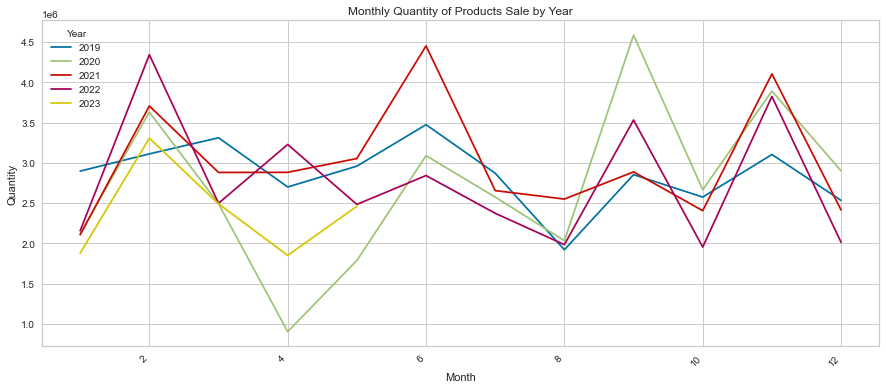

In [37]:
# Group the data by year and month, and calculate the sum of quantity
monthly_quantity = df_orders_aggr.groupby(['year', 'month'])['quantity'].sum()

monthly_quantity = monthly_quantity.reset_index()

plt.figure(figsize=(15, 6))
for year in monthly_quantity['year'].unique():
    year_data = monthly_quantity[monthly_quantity['year'] == year]
    plt.plot(year_data['month'], year_data['quantity'], label=year)

plt.title('Monthly Quantity of Products Sale by Year')
plt.xlabel('Month')
plt.ylabel('Quantity')
plt.legend(title='Year', loc='upper left')
plt.grid(True)

plt.xticks(rotation=45, ha='right')

plt.show()

We can observe a pattern in sales by month, where distributors buy more before and after vacations. There are four peaks, in February, after Christmas June, before Summer, September, after summer and november before christmas holidays. Also we observe there is a minimum the April of 2020 due to covid(state of emergency was declared the 14th of March, from 14th of March to 14th of April confinament). Then, those late sales are recovered the rest of the year having two meaningful peaks in September 2020 and December 2020.

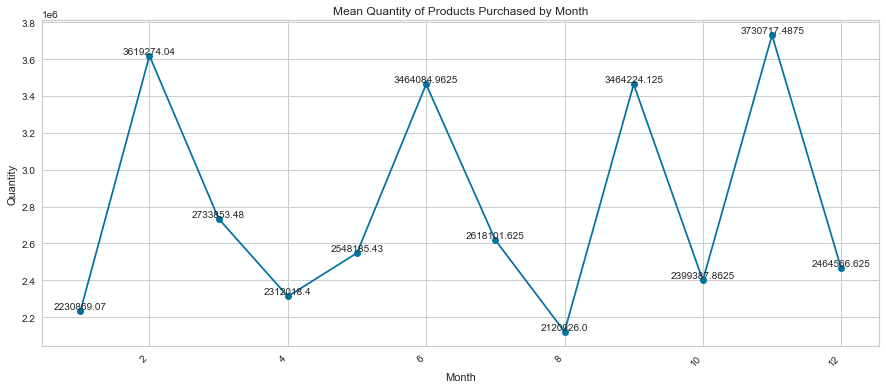

In [38]:
# Group the data by year and month, and calculate the sum of quantity
monthly_quantity = df_orders_aggr.groupby(['year', 'month'])['quantity'].sum().reset_index()

monthly_quantity_mean = monthly_quantity.groupby(['month'])['quantity'].mean()

plt.figure(figsize=(15, 6))
monthly_quantity_mean.plot(kind='line', marker='o', linestyle='-', color='b')

plt.title('Mean Quantity of Products Purchased by Month')
plt.xlabel('Month')
plt.ylabel('Quantity')
plt.grid(True)

plt.xticks(rotation=45, ha='right')

# Add data labels (optional)
for x, y in zip(monthly_quantity_mean.index, monthly_quantity_mean.values):
    plt.text(x, y, str(y), ha='center', va='bottom')

plt.show()

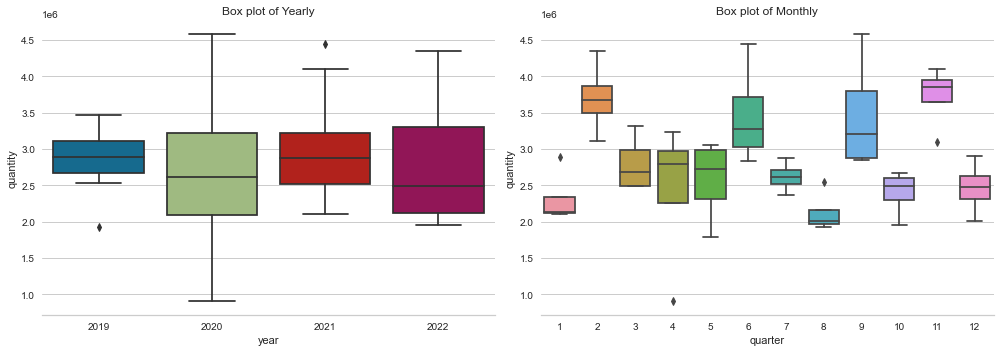

In [39]:
dtf_ts_line = df_orders_aggr.groupby(['month', 'year'])['quantity'].sum().reset_index()
dtf_ts_line = dtf_ts_line[dtf_ts_line.year < 2023]

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.subplots_adjust(wspace=0.2)
sns.boxplot(x="year", y="quantity", data=dtf_ts_line)
plt.xlabel('year')
plt.title('Box plot of Yearly')
sns.despine(left=True)
plt.tight_layout()
plt.subplot(1,2,2)
sns.boxplot(x="month", y="quantity", data=dtf_ts_line)
plt.xlabel('quarter')
plt.title('Box plot of Monthly')
sns.despine(left=True)
plt.tight_layout();

### Stationarity

Perfom adfuller test in total sales, sales by customer, and sales by product

In [ ]:
result = adfuller(dtf_ts_line['quantity'])
print("Test statistic in total sales: ",result[0] , "with p-value: ", result[1]) 

Test statistic in total sales:  -4.634046943853169 with p-value:  0.00011173758860822808


In [37]:
dft_customer = df_orders_aggr[df_orders_aggr.customer_id == 0].groupby(['month', 'year'])['quantity'].sum().reset_index()
result = adfuller(dft_customer['quantity'])
print("Test statistic in sales of customer 0: ",result[0] , "with p-value: ", result[1]) 

Test statistic in sales of customer 0:  -2.9866381443057315 with p-value:  0.03616121172405051


In [38]:
dft_customer = df_orders_aggr[df_orders_aggr.customer_id == 111].groupby(['month', 'year'])['quantity'].sum().reset_index()
result = adfuller(dft_customer['quantity'])
print("Test statistic in sales of customer 111: ",result[0] , "with p-value: ", result[1]) 

Test statistic in sales of customer 111:  -1.7922727804484626 with p-value:  0.38430473600954757


In [39]:
dft_material = df_orders_aggr[df_orders_aggr.material_id == 10].groupby(['month', 'year'])['quantity'].sum().reset_index()
result = adfuller(dft_material['quantity'])
print("Test statistic in sales of product 10: ",result[0] , "with p-value: ", result[1]) 

Test statistic in sales of product 10:  -2.3945064025224516 with p-value:  0.14329294319831049


In [41]:
dft_material = df_orders_aggr[df_orders_aggr.material_id == 111].groupby(['month', 'year'])['quantity'].sum().reset_index()
result = adfuller(dft_material['quantity'])
print("Test statistic in sales of product 111: ",result[0] , "with p-value: ", result[1]) 

Test statistic in sales of product 111:  -7.516234203250942 with p-value:  3.8966673186707254e-11


### Autocorrelation

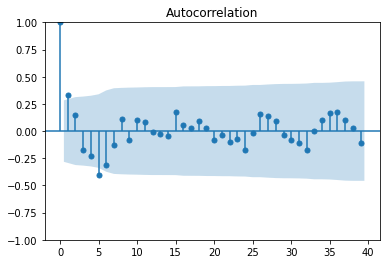

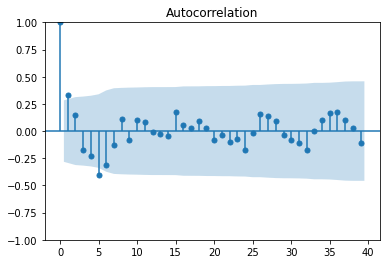

In [44]:
plot_acf(dtf_ts_line.quantity, lags = 39) # Autocorrelation of total sales

In [16]:
df_cust = df_orders_aggr[df_orders_aggr['customer_id'] == 0]
df_cust = df_cust.groupby(['sequence_number'])['quantity'].sum().reset_index()

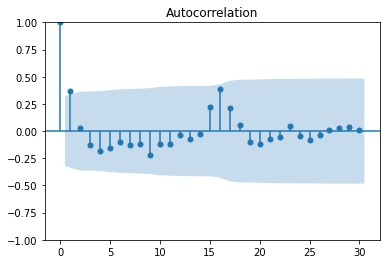

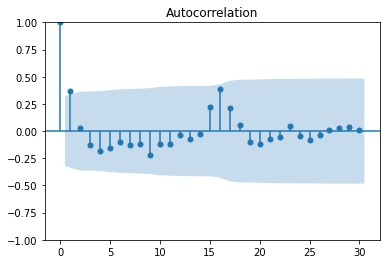

In [46]:
plot_acf(df_cust.quantity, lags = 30) # Autocorrelation of customer 0

In [47]:
df_prod = df_orders_aggr[df_orders_aggr['material_id'] == 111]
df_prod = df_prod.groupby(['sequence_number'])['quantity'].sum().reset_index()

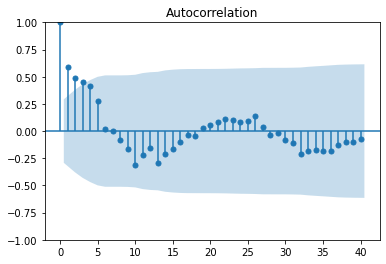

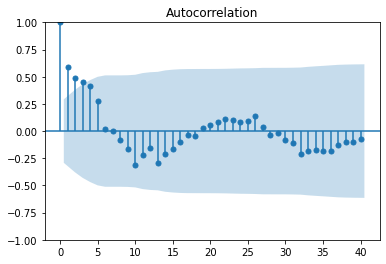

In [48]:

plot_acf(df_prod.quantity, lags = 40) # Autocorrelation of product 111

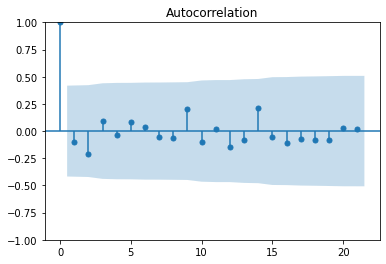

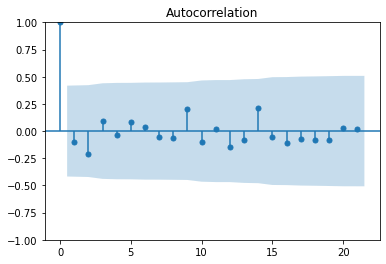

In [50]:
df_prod = df_orders_aggr[df_orders_aggr['material_id'] == 10]
df_prod = df_prod.groupby(['sequence_number'])['quantity'].sum().reset_index()
plot_acf(df_prod.quantity, lags = 21) # Autocorrelation of product 10

### Modeling

In [55]:
# Encode customer_business_unit
label_encoder_bu = LabelEncoder()
df_orders_aggr['customer_business_unit'] = label_encoder_bu.fit_transform(df_orders_aggr['customer_business_unit'])

# Encode customer_city
label_encoder_city = LabelEncoder()
df_orders_aggr['customer_city'] = label_encoder_city.fit_transform(df_orders_aggr['customer_city'])

# Encode customer_city
label_encoder_class = LabelEncoder()
df_orders_aggr['mat_classification_2'] = label_encoder_class.fit_transform(df_orders_aggr['mat_classification_2'])

In [56]:
# This will include negative values to the dataset based on the previour purchases
df_orders_aggr = df_orders_aggr[df_orders_aggr['year'] > 2020] # Avoid covid year
dataset = df_orders_aggr.pivot_table(index = ['customer_id','material_id','mat_classification_2', 'mean_price', 'customer_business_unit', 'customer_province', 'customer_city'],values = ['quantity'],columns = ['sequence_number'],fill_value = 0,aggfunc='sum')
dataset.reset_index(inplace = True)

# Binary dataset will be used to perform a classification model (user will purchase the product or not)
dataset_binary = dataset.copy()
dataset_binary['quantity'] = np.where(dataset_binary['quantity'] > 0, 1, 0)

In [57]:
import math 

# Create a dataframe with negative samples and ordered by sequence
RUS = RandomUnderSampler(random_state = 42, sampling_strategy = 0.4)
X = pd.DataFrame()
X_res = pd.DataFrame()
y_res = []
sequence_df = pd.DataFrame()

for i in range(24,53):    
    sequence_df['customer_id'] = dataset_binary['customer_id']
    sequence_df['material_id'] = dataset_binary['material_id']
    sequence_df['sequence'] = i - 24
    sequence_df['year'] = math.floor(i / 12)
    sequence_df['month'] = i - 12 * sequence_df['year']
    sequence_df['customer_province'] = dataset_binary['customer_province']
    sequence_df['customer_city'] = dataset_binary['customer_city']
    sequence_df['mat_classification_2'] = dataset_binary['mat_classification_2']
    sequence_df['mean_price'] = dataset_binary['mean_price']
    sequence_df['customer_business_unit'] = dataset_binary['customer_business_unit']
    X_res, y_res = RUS.fit_resample(sequence_df[['customer_id', 'material_id', 'mat_classification_2', 'mean_price', 'sequence', 'month', 'year', 'customer_province', 'customer_city', 'customer_business_unit']], dataset_binary[('quantity', i)])
    X_res['is_purchased'] = y_res
    X_res = X_res.sample(frac = 1)

    X = pd.concat([X, X_res])

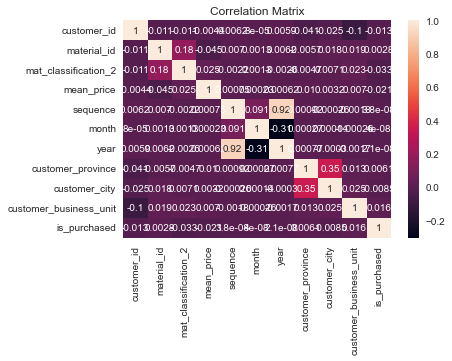

In [58]:
correlation_matrix = X.corr()
sns.heatmap(correlation_matrix, annot =True)
plt.title("Correlation Matrix")
plt.show()

In [59]:
correlation_matrix['is_purchased']

customer_id              -1.265380e-02
material_id               2.792935e-03
mat_classification_2     -3.283667e-02
mean_price               -2.129119e-02
sequence                  3.816086e-08
month                     4.042608e-08
year                      2.064170e-08
customer_province         6.140799e-03
customer_city            -8.464624e-03
customer_business_unit    1.575725e-02
is_purchased              1.000000e+00
Name: is_purchased, dtype: float64

In [81]:
# Divide into train test and validation datasets
train_orders = X[X['year'] < X['year'].max()]
test_orders = X[X['year'] == X['year'].max()]
validation_orders = test_orders[test_orders['month'] < test_orders['month'].max() - 1]
test_orders = test_orders[test_orders['month'] >= test_orders['month'].max() - 1]

In [82]:
# Create dataset to predict quantities (strictly positive samples)
X_retrain = df_orders_aggr[['customer_id', 'material_id','sequence_number','mean_price','mat_classification_2', 'quantity', 'year', 'month', 'customer_province', 'customer_city', 'customer_business_unit']]
X_retrain = X_retrain.rename(columns={'sequence_number': 'sequence'})

# Divide into train test and validation datasets
train_orders_quantity = X_retrain[X_retrain['year'] < X_retrain['year'].max()]
test_orders_quantity = X_retrain[X_retrain['year'] == X_retrain['year'].max()]
validation_orders_quantity = test_orders_quantity[test_orders_quantity['month'] < test_orders_quantity['month'].max() - 1]
test_orders_quantity = test_orders_quantity[test_orders_quantity['month'] >= test_orders_quantity['month'].max() - 1]

### PyCaret

First, we use PyCaret to find the best machine learning model. PyCaret is an open-source Python library. It provides an easy-to-use framework to perform machine learning tasks

In [20]:
import pycaret
from pycaret.classification import setup, compare_models, finalize_model

clf = setup(train_orders.reset_index(), target = 'is_purchased')
best_model = compare_models(errors="raise")
trained_model = finalize_model(best_model)

,Description,Value
0,Session id,6691
1,Target,is_purchased
2,Target type,Binary
3,Original data shape,"(8065045, 10)"
4,Transformed data shape,"(8065045, 10)"
5,Transformed train set shape,"(5645531, 10)"
6,Transformed test set shape,"(2419514, 10)"
7,Numeric features,9
8,Preprocess,True
9,Imputation type,simple


,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,13:25:42
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Extra Trees Classifier


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
dt,Decision Tree Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,8.2920
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,202.1780
gbc,Gradient Boosting Classifier,0.9951,0.9999,0.9995,0.9837,0.9915,0.9881,0.9881,437.0310
ada,Ada Boost Classifier,0.9804,0.9982,0.9803,0.9526,0.9662,0.9525,0.9527,89.0980
knn,K Neighbors Classifier,0.9309,0.9745,0.9285,0.8450,0.8848,0.8356,0.8375,30.3030
ridge,Ridge Classifier,0.9123,0.0000,0.8683,0.8321,0.8498,0.7879,0.7882,2.7170
lda,Linear Discriminant Analysis,0.9118,0.9735,0.8861,0.8199,0.8517,0.7891,0.7903,5.4370
nb,Naive Bayes,0.9053,0.9689,0.8485,0.8251,0.8366,0.7700,0.7702,3.5160
lr,Logistic Regression,0.8336,0.9051,0.7529,0.6922,0.7212,0.6030,0.6041,21.3110
svm,SVM - Linear Kernel,0.8079,0.0000,0.7300,0.6871,0.6590,0.5370,0.5680,374.0780


Processing:   0%|          | 0/61 [00:00<?, ?it/s]

We use the best model predicted and test it, trying to avoid overfitting

In [45]:
cb = DecisionTreeClassifier(max_depth=4) # Max depth to avoid overfitting

# Train data
Xtrain_orders = train_orders
ytrain_orders = Xtrain_orders['is_purchased']
Xtrain_orders = Xtrain_orders.drop(['is_purchased'], axis = 1).reset_index()

cb.fit(Xtrain_orders, ytrain_orders) # Fit the model to train data

# Test data
X_test = test_orders
y_test = X_test['is_purchased']
X_test = X_test.drop(['is_purchased'], axis = 1).reset_index()

# Predictions
train_predictions = cb.predict(Xtrain_orders)
test_predictions = cb.predict(X_test)

# Evaluate the model's performance
train_accuracy = accuracy_score(ytrain_orders, train_predictions)
test_accuracy = accuracy_score(y_test, test_predictions)

print("Training accuracy:", train_accuracy)
print("Training F1 score:", f1_score(ytrain_orders, train_predictions))
print("Training recall:", recall_score(ytrain_orders, train_predictions))
print()
print("Testing accuracy:", test_accuracy)
print("Testing F1 score:", f1_score(y_test, test_predictions))
print("Testing recall:", recall_score(y_test, test_predictions))

Training accuracy: 0.9237064393317086
Training F1 score: 0.855548828341879
Training recall: 0.7907685631211214

Testing accuracy: 0.8010357004327172
Testing F1 score: 0.5134978670290733
Testing recall: 0.3675082572258072


Then, we do the same for predicting quantity, note that now we use regression models

In [49]:
clf_reg = regression.setup(train_orders_quantity.reset_index(), target = 'quantity')
best_model_reg = regression.compare_models(errors="raise")
trained_model_reg = regression.finalize_model(best_model_reg)

,Description,Value
0,Session id,1644
1,Target,quantity
2,Target type,Regression
3,Original data shape,"(2306448, 10)"
4,Transformed data shape,"(2306448, 10)"
5,Transformed train set shape,"(1614513, 10)"
6,Transformed test set shape,"(691935, 10)"
7,Numeric features,9
8,Preprocess,True
9,Imputation type,simple


,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:31:33
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Random Forest Regressor


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
dt,Decision Tree Regressor,26.4330,377774.1544,588.2005,0.0980,1.0000,2.0829,5.1770
knn,K Neighbors Regressor,36.7854,396304.7312,627.3305,0.0580,1.1638,5.5830,3.5040
lr,Linear Regression,45.0734,428527.1546,650.6480,0.0001,2.0136,12.2625,1.4950
lasso,Lasso Regression,45.0763,428527.5428,650.6483,0.0001,2.0144,12.2727,0.4970
ridge,Ridge Regression,45.0734,428527.1546,650.6480,0.0001,2.0136,12.2625,0.3640
en,Elastic Net,45.0768,428527.6987,650.6484,0.0001,2.0144,12.2726,0.5470
omp,Orthogonal Matching Pursuit,45.0025,428554.4700,650.6686,0.0001,2.0197,12.2973,0.4010
br,Bayesian Ridge,45.0686,428528.5418,650.6491,0.0001,2.0149,12.2749,0.5290
llar,Lasso Least Angle Regression,44.6525,428581.7419,650.6891,-0.0000,2.0105,12.0265,0.3790
lar,Least Angle Regression,47.7766,429252.3878,651.1891,-0.0015,2.0953,12.5837,0.3710


Processing:   0%|          | 0/77 [00:00<?, ?it/s]

: 

In [62]:
from sklearn.preprocessing import StandardScaler

class OrdersDataLoader(Dataset):

    def __init__(self, orders):
        self.users, self.items, self.time_features, self.user_features,self.item_features, self.labels = self.get_dataset(orders)

    def __len__(self):
        return len(self.users)
  
    def __getitem__(self, idx):
        return self.users[idx], self.items[idx], self.time_features[idx], self.user_features[idx], self.item_features[idx], self.labels[idx]

    def get_dataset(self, orders):
        orders = orders
        users = orders.customer_id.values.tolist()
        items = orders.material_id.values.tolist()
        time_features = orders[['sequence', 'month', 'year']].values.tolist()
        user_features = orders[['customer_province', 'customer_city', 'customer_business_unit']].values.tolist()
        item_features = orders[['mean_price', 'mat_classification_2']].values.tolist()
        labels = orders.is_purchased.values.tolist()


        return torch.tensor(users), torch.tensor(items), torch.tensor(time_features), torch.tensor(user_features), torch.tensor(item_features), torch.tensor(labels)

In [97]:
import torch.nn.functional as F

class RecNN(pl.LightningModule):
    
    def __init__(self, num_users, num_items, train_orders, test_orders):
        super().__init__()
        self.user_embedding = nn.Embedding(num_embeddings=num_users, embedding_dim=64)
        self.fc_user_embedding = nn.Sequential(nn.Linear(in_features=64, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.item_embedding = nn.Embedding(num_embeddings=num_items, embedding_dim=64)
        self.fc_item_embedding = nn.Sequential(nn.Linear(in_features=64, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.fc1 = nn.Sequential(nn.Linear(in_features=64, out_features=64), nn.BatchNorm1d(64), nn.ReLU(), nn.Dropout(0.2))

        self.time_fc = nn.Sequential(nn.Linear(in_features=3, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.time_fc2 = nn.Sequential(nn.Linear(in_features=32, out_features=64), nn.ReLU())

        self.user_fc = nn.Sequential(nn.Linear(in_features=3, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.user_fc2 = nn.Sequential(nn.Linear(in_features=32, out_features=64), nn.ReLU())

        self.item_fc = nn.Sequential(nn.Linear(in_features=2, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.item_fc2 = nn.Sequential(nn.Linear(in_features=32, out_features=64), nn.ReLU())

        self.fc2 = nn.Sequential(nn.Linear(in_features=256, out_features=192), nn.ReLU())
        self.fc3 = nn.Sequential(nn.Linear(in_features=192, out_features=128), nn.BatchNorm1d(128), nn.ReLU(), nn.Dropout(0.2))
        self.fc4 = nn.Sequential(nn.Linear(in_features=128, out_features=96), nn.ReLU(), nn.Dropout(0.2))
        self.fc5 = nn.Sequential(nn.Linear(in_features=96, out_features=32), nn.ReLU(), nn.Dropout(0.2))
        self.fc6 = nn.Sequential(nn.Linear(in_features=32, out_features=16), nn.ReLU())
        self.output = nn.Linear(in_features=16, out_features=1)
        self.train_orders = train_orders
        self.test_orders = test_orders

        
        
    def forward(self, user_input, item_input, time_features, user_features, item_features):
        # Pass through embedding layers
        user_embedded = self.user_embedding(user_input)
        user_embedded = self.fc_user_embedding(user_embedded)
        item_embedded = self.item_embedding(item_input)
        item_embedded = self.fc_item_embedding(item_embedded)

        # Concat the embedding layers
        vector = torch.cat([user_embedded, item_embedded], dim=-1)
        vector = self.fc1(vector)

        # Features layers
        time_vector = self.time_fc(time_features.to(torch.float32))
        time_vector = self.time_fc2(time_vector)
        user_vector = self.user_fc(user_features.to(torch.float32))
        user_vector = self.user_fc2(user_vector)
        item_vector = self.item_fc(item_features.to(torch.float32))
        item_vector = self.item_fc2(item_vector)

        # Concat features layers
        vector = torch.cat([vector, time_vector], dim=-1)
        vector = torch.cat([vector, user_vector], dim=-1)
        vector = torch.cat([vector, item_vector], dim=-1)

        # Pass through dense layers 
        vector = self.fc2(vector)
        vector = self.fc3(vector)
        vector = self.fc4(vector)
        vector = self.fc5(vector)
        vector = self.fc6(vector)

        # Output layer
        pred = nn.Sigmoid()(self.output(vector))
        return pred
    
    def training_step(self, batch, batch_idx):
        user_input, item_input, time_features, user_features, item_features, labels = batch
        predicted_labels = self.forward(user_input, item_input, time_features, user_features, item_features)
        loss = F.binary_cross_entropy(predicted_labels, labels.view(-1, 1).float())
        preds = torch.where(predicted_labels < 0.5, torch.tensor(0), torch.tensor(1))
        accuracy = accuracy_score(preds, labels)        
        self.log("training_loss", loss, on_step = True, on_epoch= True, prog_bar = True, logger = True)
        self.log("training_accuracy", accuracy, on_step = True, on_epoch= True, prog_bar = True, logger = True)
        return loss
        
    
    def validation_step(self, batch, batch_idx):
        user_input, item_input, time_features, user_features, item_features, labels = batch
        predicted_labels = self.forward(user_input, item_input, time_features, user_features, item_features)
        loss = F.binary_cross_entropy(predicted_labels, labels.view(-1, 1).float())
        preds = torch.where(predicted_labels < 0.5, torch.tensor(0), torch.tensor(1))
        accuracy = accuracy_score(preds, labels)
        self.log("validation_loss", loss, on_step = True, on_epoch= True, prog_bar = True, logger = True)
        self.log("validation_accuracy", accuracy, on_step = True, on_epoch= True, prog_bar = True, logger = True)

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr = 0.000005)

    def train_dataloader(self):
        return DataLoader(OrdersDataLoader(self.train_orders),
                          batch_size=512, num_workers=0)
    
    def val_dataloader(self):
        return DataLoader(OrdersDataLoader(self.test_orders),
                          batch_size=512, num_workers=0)


In [98]:
num_users = X['customer_id'].max() + 1
num_items = X['material_id'].max() + 1
scaler = StandardScaler() # standarize data

columns = train_orders.columns.to_list()
columns.remove('is_purchased')
columns.remove('customer_id')
columns.remove('material_id')

scaler.fit(train_orders[columns])

train_orders[columns] = scaler.transform(train_orders[columns])
validation_orders[columns] = scaler.transform(validation_orders[columns])

model = RecNN(num_users, num_items, train_orders.reset_index(), validation_orders.reset_index())

In [95]:
trainer = pl.Trainer(max_epochs=5, accelerator="cpu", reload_dataloaders_every_n_epochs = 1, logger = False, enable_checkpointing=None )

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


In [99]:
trainer.fit(model)


   | Name              | Type       | Params
--------------------------------------------------
0  | user_embedding    | Embedding  | 64.3 K
1  | fc_user_embedding | Sequential | 2.1 K 
2  | item_embedding    | Embedding  | 1.9 M 
3  | fc_item_embedding | Sequential | 2.1 K 
4  | fc1               | Sequential | 4.3 K 
5  | time_fc           | Sequential | 192   
6  | time_fc2          | Sequential | 2.1 K 
7  | user_fc           | Sequential | 192   
8  | user_fc2          | Sequential | 2.1 K 
9  | item_fc           | Sequential | 160   
10 | item_fc2          | Sequential | 2.1 K 
11 | fc2               | Sequential | 49.3 K
12 | fc3               | Sequential | 25.0 K
13 | fc4               | Sequential | 12.4 K
14 | fc5               | Sequential | 3.1 K 
15 | fc6               | Sequential | 528   
16 | output            | Linear     | 17    
--------------------------------------------------
2.1 M     Trainable params
0         Non-trainable params
2.1 M     Total params
8.297 

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
import pickle

with open('model_nn.pkl', 'wb') as f:
        pickle.dump(model, f)

In [ ]:
import pickle

with open('model_nn.pkl', 'rb') as f:
    model = pickle.load(f)


In [ ]:
y_predict = model(torch.tensor(test_orders.customer_id.values.tolist()), torch.tensor(test_orders.material_id.values.tolist()), torch.tensor(test_orders[['sequence', 'month', 'year']].values.tolist()).float(), torch.tensor(test_orders[['customer_province', 'customer_city', 'customer_business_unit']].values.tolist()).float()).detach().numpy().flatten()
y_test = test_orders.is_purchased.tolist()
y_pred = np.where(y_predict  < 0.3, 0, 1)

In [ ]:
accuracy_score(test_orders.is_purchased, y_pred)

0.627366133872005

In [ ]:
recall_score(test_orders.is_purchased, y_pred)

0.4582319545823195

In [ ]:
f1_score(test_orders.is_purchased, y_pred)

0.412694716004425

In [ ]:
import torch.nn.functional as F

class RecQNN(pl.LightningModule):
    
    def __init__(self, num_users, num_items, train_orders, test_orders):
        super().__init__()
        self.user_embedding = nn.Embedding(num_embeddings=num_users, embedding_dim=64)
        self.fc_user_embedding = nn.Sequential(nn.Linear(in_features=64, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.item_embedding = nn.Embedding(num_embeddings=num_items, embedding_dim=64)
        self.fc_item_embedding = nn.Sequential(nn.Linear(in_features=64, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.fc1 = nn.Sequential(nn.Linear(in_features=64, out_features=64), nn.BatchNorm1d(64), nn.ReLU(), nn.Dropout(0.2))

        self.time_fc = nn.Sequential(nn.Linear(in_features=3, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.time_fc2 = nn.Sequential(nn.Linear(in_features=32, out_features=64), nn.ReLU())

        self.user_fc = nn.Sequential(nn.Linear(in_features=3, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.user_fc2 = nn.Sequential(nn.Linear(in_features=32, out_features=64), nn.ReLU())

        self.item_fc = nn.Sequential(nn.Linear(in_features=2, out_features=32), nn.BatchNorm1d(32), nn.ReLU())
        self.item_fc2 = nn.Sequential(nn.Linear(in_features=32, out_features=64), nn.ReLU())

        self.fc2 = nn.Sequential(nn.Linear(in_features=256, out_features=192), nn.ReLU())
        self.fc3 = nn.Sequential(nn.Linear(in_features=192, out_features=128), nn.BatchNorm1d(128), nn.ReLU(), nn.Dropout(0.2))
        self.fc4 = nn.Sequential(nn.Linear(in_features=128, out_features=96), nn.ReLU(), nn.Dropout(0.2))
        self.fc5 = nn.Sequential(nn.Linear(in_features=96, out_features=32), nn.ReLU(), nn.Dropout(0.2))
        self.fc6 = nn.Sequential(nn.Linear(in_features=32, out_features=16), nn.ReLU())
        self.output = nn.Linear(in_features=16, out_features=1)
        self.train_orders = train_orders
        self.test_orders = test_orders

        
        
    def forward(self, user_input, item_input, time_features, user_features, item_features):
        # Pass through embedding layers
        user_embedded = self.user_embedding(user_input)
        user_embedded = self.fc_user_embedding(user_embedded)
        item_embedded = self.item_embedding(item_input)
        item_embedded = self.fc_item_embedding(item_embedded)

        # Concat the embedding layers
        vector = torch.cat([user_embedded, item_embedded], dim=-1)
        vector = self.fc1(vector)

        # Features layers
        time_vector = self.time_fc(time_features.to(torch.float32))
        time_vector = self.time_fc2(time_vector)
        user_vector = self.user_fc(user_features.to(torch.float32))
        user_vector = self.user_fc2(user_vector)
        item_vector = self.item_fc(item_features.to(torch.float32))
        item_vector = self.item_fc2(item_vector)

        # Concat features layers
        vector = torch.cat([vector, time_vector], dim=-1)
        vector = torch.cat([vector, user_vector], dim=-1)
        vector = torch.cat([vector, item_vector], dim=-1)

        # Pass through dense layers 
        vector = self.fc2(vector)
        vector = self.fc3(vector)
        vector = self.fc4(vector)
        vector = self.fc5(vector)
        vector = self.fc6(vector)

        # Output layer
        pred = self.output(vector)
        return pred
    
    def training_step(self, batch, batch_idx):
        user_input, item_input, time_features, user_features, item_features, labels = batch
        predicted_labels = self.forward(user_input, item_input, time_features, user_features, item_features)
        loss = nn.MSELoss()(predicted_labels, labels.view(-1, 1).float())
        preds = torch.where(predicted_labels < 0.5, torch.tensor(0), torch.tensor(1))
        accuracy = accuracy_score(preds, labels)        
        self.log("training_loss", loss, on_step = True, on_epoch= True, prog_bar = True, logger = True)
        self.log("training_accuracy", accuracy, on_step = True, on_epoch= True, prog_bar = True, logger = True)
        return loss
        
    
    def validation_step(self, batch, batch_idx):
        user_input, item_input, time_features, user_features, item_features, labels = batch
        predicted_labels = self.forward(user_input, item_input, time_features, user_features, item_features)
        loss = nn.MSELoss()(predicted_labels, labels.view(-1, 1).float())
        preds = torch.where(predicted_labels < 0.5, torch.tensor(0), torch.tensor(1))
        accuracy = accuracy_score(preds, labels)
        self.log("validation_loss", loss, on_step = True, on_epoch= True, prog_bar = True, logger = True)
        self.log("validation_accuracy", accuracy, on_step = True, on_epoch= True, prog_bar = True, logger = True)

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr = 0.00001)

    def train_dataloader(self):
        return DataLoader(OrdersDataLoader(self.train_orders),
                          batch_size=512, num_workers=0)
    
    def val_dataloader(self):
        return DataLoader(OrdersDataLoader(self.test_orders),
                          batch_size=512, num_workers=0)


In [264]:
num_users = X['customer_id'].max() + 1
num_items = X['material_id'].max() + 1

scaler = StandardScaler() # standarize data

columns = train_orders_quantity.columns.to_list()
columns.remove('is_purchased')
columns.remove('customer_id')
columns.remove('material_id')

scaler.fit(train_orders_quantity[columns])

train_orders_quantity[columns] = scaler.transform(train_orders_quantity[columns])
validation_orders_quantity[columns] = scaler.transform(validation_orders_quantity[columns])

model_pretrained = RecQNN(num_users, num_items, train_orders, validation_orders)
model_pretrained.load_state_dict(model.state_dict())

In [266]:
for name, param in model_pretrained.named_parameters():
    if name in ("user_embedding.weight", "item_embedding.weight"):
        param.requires_grad = False

True
True


In [260]:
trainer = pl.Trainer(max_epochs=5, accelerator="cpu", reload_dataloaders_every_n_epochs = 1, logger = False, enable_checkpointing=False )

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


In [265]:
trainer.fit(model_pretrained)


  | Name           | Type       | Params
----------------------------------------------
0 | user_embedding | Embedding  | 64.3 K
1 | item_embedding | Embedding  | 1.9 M 
2 | fc1            | Sequential | 12.6 K
3 | time_fc        | Sequential | 192   
4 | user_fc        | Sequential | 192   
5 | fc2            | Sequential | 15.6 K
6 | fc3            | Sequential | 6.2 K 
7 | fc4            | Sequential | 2.1 K 
8 | output         | Linear     | 33    
----------------------------------------------
2.0 M     Trainable params
0         Non-trainable params
2.0 M     Total params
8.022     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

tensor([  1.,   2.,   6.,   2.,  10.,  10.,   2.,   2.,   4.,   1.,   1.,   1.,
          1.,   3.,   2.,   1.,   2.,   2.,   4.,   2.,   2.,   2.,   1.,   2.,
          1.,   1.,   2.,   1.,   1.,   1.,   1.,  15.,   1.,   1.,   1.,   1.,
          1.,  37.,   1.,   4.,   3.,   1.,   2.,   1.,   1.,   2.,   2.,   1.,
          1.,   1.,   5.,   1.,   1.,   1.,   1.,   4.,   1.,   1.,   1.,   1.,
          2.,   2.,   1.,   1.,   2.,   2.,   2.,   1.,   2.,   4.,   1.,   1.,
          1.,   2.,   2.,   2.,   4.,   1.,   2.,   1.,   4.,   1.,   6.,   1.,
          1.,   2.,   2.,  12.,   9.,  20.,  30.,  25.,  19.,  31.,   1.,  38.,
          5.,  25.,  36.,  16.,   6.,   1.,   6., 150.,   9.,  50.,  78.,   3.,
         12.,  50.,  55., 470., 151.,  14.,  10.,  34.,  10.,  10.,  14.,  84.,
          2.,  31.,   6.,   6.,  12.,  89.,   3.,   2.,  11.,  13.,  45.,   7.,
          4.,  12.,  85.,  31.,   5.,   7.,  18.,  20.,  65.,  30.,  24.,  35.,
         10.,   2.,   6.,  10.,  20.,  1

In [453]:
y_predict = model_pretrained(torch.tensor(test_quantity_orders.customer_id.tolist()), torch.tensor(test_quantity_orders.material_id.tolist()), torch.tensor(test_quantity_orders.sequence.tolist())).detach().numpy().flatten()

In [454]:
y_predict

array([12.657032, 12.354437, 14.184767, ..., 24.17368 , 22.289093,
       17.67381 ], dtype=float32)

In [ ]:
sequence_dim = sequence_df.shape[0]
num_users = orders['customer_id'].nunique()+1
num_items = orders['material_id'].nunique()+1
all_materials = orders['material_id'].unique()
embedding_dim = 4
hidden_dim = 100

model = NCF(num_users, num_items, train_orders, all_materials)

In [ ]:
trainer = pl.Trainer(max_epochs=5, accelerator="cpu", reload_dataloaders_every_n_epochs = 1, logger = False, enable_checkpointing=False )

In [ ]:
trainer.fit(model)